# Collect and check birdsongs data from xenocanto

In [5]:
import pandas as pd
import numpy as np
import os
import requests
import time
from datetime import date 
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
#import geoplot
#import descartes
import geopandas as gpd
from shapely.geometry import Point, Polygon

Create directory structure

In [6]:
home_path = os.path.abspath('.')
figures_path = os.path.join(home_path, 
                                'figures')
data_path = os.path.join(home_path, 
                                'data')

#os.mkdir(figures_path)
#os.mkdir(data_path)
my_home_url = "https://www.xeno-canto.org/api/2/recordings?query=cnt:Venezuela"

In [4]:
my_request = requests.get(my_home_url)

In [5]:
pd.json_normalize(my_request.json())

,numRecordings,numSpecies,page,numPages,recordings
0,7766,960,1,16,"[{'id': '231261', 'gen': 'Tinamus', 'sp': 'tao..."


## Retrieve and export the raw data
Create a loop to navigate and retrieve all pages from Venezuela (16) and export the data to a csv local file

In [6]:
n_pages = 16
frames= []
my_home_url = "https://www.xeno-canto.org/api/2/recordings?query=cnt:Venezuela&page=" 

for i in range(n_pages):
    my_request = requests.get(my_home_url + str(i+1))
    frames.append(pd.json_normalize(my_request.json(), record_path='recordings'))
    time.sleep(0.5)


my_df = pd.concat(frames, ignore_index=True)
del frames

# add a column with the correct species name
my_df['full_sp_name'] = my_df['gen'] + '_' + my_df['sp'] 
my_df['full_ssp_name'] = my_df['gen'] + '_' + my_df['sp'] + '_' + my_df['ssp']

# export the dataframe
my_df.to_csv(os.path.join(data_path, 
                          str(date.today().strftime("%Y%m%d")) + "_" + "raw_data.csv"),
             index=None)
my_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7766 entries, 0 to 7765
Data columns (total 31 columns):
 #   Column         Non-Null Count  Dtype 
---  ------         --------------  ----- 
 0   id             7766 non-null   object
 1   gen            7766 non-null   object
 2   sp             7766 non-null   object
 3   ssp            7766 non-null   object
 4   en             7766 non-null   object
 5   rec            7766 non-null   object
 6   cnt            7766 non-null   object
 7   loc            7766 non-null   object
 8   lat            7464 non-null   object
 9   lng            7463 non-null   object
 10  alt            7766 non-null   object
 11  type           7766 non-null   object
 12  url            7766 non-null   object
 13  file           7766 non-null   object
 14  file-name      7766 non-null   object
 15  lic            7766 non-null   object
 16  q              7766 non-null   object
 17  length         7766 non-null   object
 18  time           7766 non-null

## Load the local csv file

In [7]:
my_df = pd.read_csv(os.path.join(data_path,
                                 str(date.today().strftime("%Y%m%d")) + "_" + "raw_data.csv"))
my_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7766 entries, 0 to 7765
Data columns (total 31 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   id             7766 non-null   int64  
 1   gen            7766 non-null   object 
 2   sp             7766 non-null   object 
 3   ssp            1252 non-null   object 
 4   en             7766 non-null   object 
 5   rec            7766 non-null   object 
 6   cnt            7766 non-null   object 
 7   loc            7766 non-null   object 
 8   lat            7464 non-null   float64
 9   lng            7463 non-null   float64
 10  alt            7429 non-null   object 
 11  type           7766 non-null   object 
 12  url            7766 non-null   object 
 13  file           7766 non-null   object 
 14  file-name      7766 non-null   object 
 15  lic            7766 non-null   object 
 16  q              7766 non-null   object 
 17  length         7766 non-null   object 
 18  time    

In [10]:
colnames = my_df.columns
colnames

Index(['id', 'gen', 'sp', 'ssp', 'en', 'rec', 'cnt', 'loc', 'lat', 'lng',
       'alt', 'type', 'url', 'file', 'file-name', 'lic', 'q', 'length', 'time',
       'date', 'uploaded', 'also', 'rmk', 'bird-seen', 'playback-used',
       'sono.small', 'sono.med', 'sono.large', 'sono.full', 'full_sp_name',
       'full_ssp_name'],
      dtype='object')

## Create and export a figure with the frequency of total records (unfiltered) per Specie

In [9]:
fig, ax = plt.subplots(figsize=(150,20), dpi=300)
my_df['full_sp_name'].value_counts().plot.bar(ax=ax)
plt.title("Number of entries (audios) per species in the full Xenocanto database" )
plt.xlabel('Species')
plt.ylabel('number of records')
plt.xticks(rotation=80)
plt.savefig(os.path.join(figures_path,
                         'Frequency_of_audio_files_per_specie.pdf'),
            format = 'pdf')

In [6]:
fig, ax = plt.subplots(figsize=(50,20), dpi=300)
my_df['rec'].value_counts().plot.bar(ax=ax)
plt.title("list of recorders in the full Xenocanto database" )
plt.xlabel('Species')
plt.ylabel('number of records')
plt.xticks(rotation=80)
plt.savefig(os.path.join(figures_path, 
                        'Frequency_of_audio_files_per_recorder.pdf'),
            format = 'pdf')

## Check the quality of the recordings base on their score

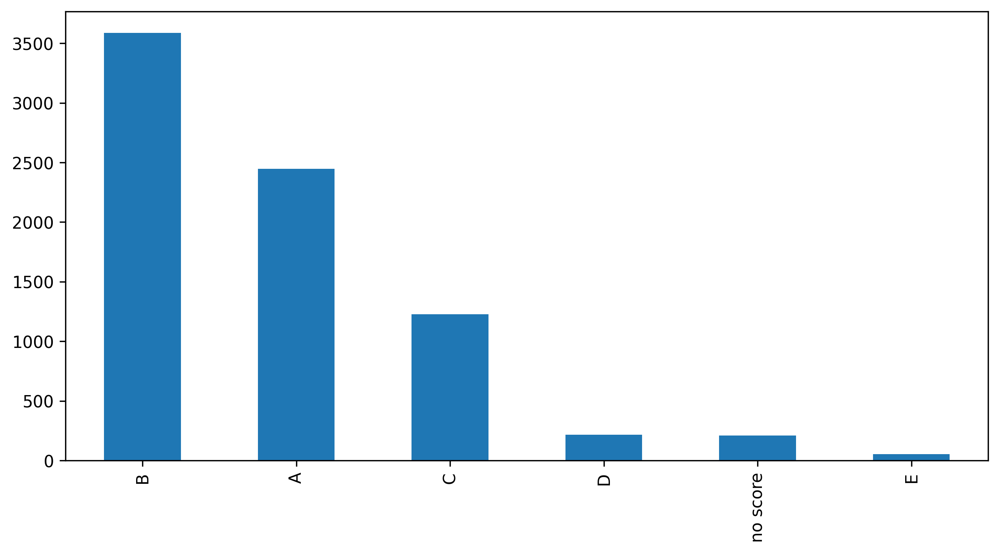

In [7]:
fig, ax = plt.subplots(figsize=(10,5), dpi=300)
my_df['q'].value_counts().plot.bar(ax=ax)
plt.savefig(os.path.join(figures_path, 
                        'Frequency_of_audio_files_per_quality.pdf'),
            format = 'pdf')

In [48]:
my_df[(my_df['q'].str.contains("A") | my_df['q'].str.contains("B"))].info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 6034 entries, 0 to 7724
Data columns (total 29 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   id             6034 non-null   int64  
 1   gen            6034 non-null   object 
 2   sp             6034 non-null   object 
 3   ssp            1056 non-null   object 
 4   en             6034 non-null   object 
 5   rec            6034 non-null   object 
 6   cnt            6034 non-null   object 
 7   loc            6034 non-null   object 
 8   lat            5814 non-null   float64
 9   lng            5813 non-null   float64
 10  alt            5740 non-null   object 
 11  type           6034 non-null   object 
 12  url            6034 non-null   object 
 13  file           6034 non-null   object 
 14  file-name      6034 non-null   object 
 15  lic            6034 non-null   object 
 16  q              6034 non-null   object 
 17  length         6034 non-null   object 
 18  time    

# Create a DF with "A" & "B" quality files and inspect

In [8]:
A_B_quality_df = my_df[(my_df['q'].str.contains("A") | my_df['q'].str.contains("B"))].reset_index(drop= True)

In [9]:
fig, ax = plt.subplots(figsize=(150,20), dpi=300)
A_B_quality_df['full_sp_name'].value_counts().plot.bar(ax=ax)
plt.title("Number of entries (audios) per species in the full Xenocanto database")
plt.xlabel('Species')
plt.ylabel('number of records')
plt.savefig(os.path.join(figures_path, 
                        'Frequency_of_good_audio_files_per_specie.pdf'),
            format = 'pdf')

In [17]:
fig, ax = plt.subplots(figsize=(50,20), dpi=300)
A_B_quality_df['rec'].value_counts().plot.bar(ax=ax)

<AxesSubplot:>

NOTE: there is an entry called Mystery_mystery repeated quite often.
Lets check it

## Exploring the valids coordenate entries

In [19]:
A_B_quality_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 6034 entries, 0 to 6033
Data columns (total 31 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   id             6034 non-null   int64  
 1   gen            6034 non-null   object 
 2   sp             6034 non-null   object 
 3   ssp            1056 non-null   object 
 4   en             6034 non-null   object 
 5   rec            6034 non-null   object 
 6   cnt            6034 non-null   object 
 7   loc            6034 non-null   object 
 8   lat            5814 non-null   float64
 9   lng            5813 non-null   float64
 10  alt            5740 non-null   object 
 11  type           6034 non-null   object 
 12  url            6034 non-null   object 
 13  file           6034 non-null   object 
 14  file-name      6034 non-null   object 
 15  lic            6034 non-null   object 
 16  q              6034 non-null   object 
 17  length         6034 non-null   object 
 18  time    

In [22]:
A_B_quality_df[(A_B_quality_df['lat'].isna() | A_B_quality_df['lng'].isna())].reset_index(drop= True).info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 221 entries, 0 to 220
Data columns (total 31 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   id             221 non-null    int64  
 1   gen            221 non-null    object 
 2   sp             221 non-null    object 
 3   ssp            22 non-null     object 
 4   en             221 non-null    object 
 5   rec            221 non-null    object 
 6   cnt            221 non-null    object 
 7   loc            221 non-null    object 
 8   lat            1 non-null      float64
 9   lng            0 non-null      float64
 10  alt            219 non-null    object 
 11  type           221 non-null    object 
 12  url            221 non-null    object 
 13  file           221 non-null    object 
 14  file-name      221 non-null    object 
 15  lic            221 non-null    object 
 16  q              221 non-null    object 
 17  length         221 non-null    object 
 18  time      

it ooks like around 220 entries have no valids coordinates for ploting. Lets try to plot it.


In [26]:
fig, ax = plt.subplots(figsize=(150,20), dpi=300)
A_B_quality_df['lat'].value_counts().plot.bar(ax=ax)
plt.title("Number of entries of LATITUDE in the 'clean' df")
plt.xlabel('Latitude')
plt.ylabel('number of entries')
plt.savefig(os.path.join(figures_path, 
                        'latitude_reported.pdf'),
            format = 'pdf')

In [27]:
fig, ax = plt.subplots(figsize=(150,20), dpi=300)
A_B_quality_df['lng'].value_counts().plot.bar(ax=ax)
plt.title("Number of entries of LONGITUDE in the 'clean' df")
plt.xlabel('Longitude')
plt.ylabel('number of entries')
plt.savefig(os.path.join(figures_path, 
                        'longitude_reported.pdf'),
            format = 'pdf')

## Create a new dataset with only entries with valid coordinates

In [65]:
A_B_quality_coor_df = A_B_quality_df[~(A_B_quality_df['lat'].isna() | A_B_quality_df['lng'].isna())].reset_index(drop= True).reset_index(drop= True)
A_B_quality_coor_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5840 entries, 0 to 5839
Data columns (total 31 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   id             5840 non-null   int64  
 1   gen            5840 non-null   object 
 2   sp             5840 non-null   object 
 3   ssp            1034 non-null   object 
 4   en             5840 non-null   object 
 5   rec            5840 non-null   object 
 6   cnt            5840 non-null   object 
 7   loc            5840 non-null   object 
 8   lat            5840 non-null   float64
 9   lng            5840 non-null   float64
 10  alt            5548 non-null   object 
 11  type           5840 non-null   object 
 12  url            5840 non-null   object 
 13  file           5840 non-null   object 
 14  file-name      5840 non-null   object 
 15  lic            5840 non-null   object 
 16  q              5840 non-null   object 
 17  length         5840 non-null   object 
 18  time    

In [10]:
#counting the total number of birds in the filtered dataset
my_total_ssp = len(A_B_quality_coor_df['full_ssp_name'].unique())
print("There are {:,} unique bird species in the dataset.".format(my_total_ssp))

There are 1,221 unique bird species in the dataset.


# Ploting the distribution of birds with good quality sound files

In [11]:
# read world map
world_map = gpd.read_file(os.path.join(data_path,
                                      'WB_countries_Admin0_10m',
                                      'WB_countries_Admin0_10m.shp'))
world_map.columns

Index(['OBJECTID', 'featurecla', 'LEVEL', 'TYPE', 'FORMAL_EN', 'FORMAL_FR',
       'POP_EST', 'POP_RANK', 'GDP_MD_EST', 'POP_YEAR', 'LASTCENSUS',
       'GDP_YEAR', 'ECONOMY', 'INCOME_GRP', 'FIPS_10_', 'ISO_A2', 'ISO_A3',
       'ISO_A3_EH', 'ISO_N3', 'UN_A3', 'WB_A2', 'WB_A3', 'CONTINENT',
       'REGION_UN', 'SUBREGION', 'REGION_WB', 'NAME_AR', 'NAME_BN', 'NAME_DE',
       'NAME_EN', 'NAME_ES', 'NAME_FR', 'NAME_EL', 'NAME_HI', 'NAME_HU',
       'NAME_ID', 'NAME_IT', 'NAME_JA', 'NAME_KO', 'NAME_NL', 'NAME_PL',
       'NAME_PT', 'NAME_RU', 'NAME_SV', 'NAME_TR', 'NAME_VI', 'NAME_ZH',
       'WB_NAME', 'WB_RULES', 'WB_REGION', 'Shape_Leng', 'Shape_Area',
       'geometry'],
      dtype='object')

In [12]:
#A_B_quality_df[A_B_quality_df['full_sp_name'].str.contains("Mystery")].info()
venezuela_map = world_map[world_map['NAME_EN'].str.contains("Venezuela")]
venezuela_map

,OBJECTID,featurecla,LEVEL,TYPE,FORMAL_EN,FORMAL_FR,POP_EST,POP_RANK,GDP_MD_EST,POP_YEAR,...,NAME_SV,NAME_TR,NAME_VI,NAME_ZH,WB_NAME,WB_RULES,WB_REGION,Shape_Leng,Shape_Area,geometry
154,155,Admin-0 country,2,Sovereign country,Bolivarian Republic of Venezuela,República Bolivariana de Venezuela,31304016,15,468600.0,2017,...,Venezuela,Venezuela,Venezuela,委內瑞拉,"Venezuela, Republica Bolivariana de","Always have ""R.B. de"" before ""Venezuela""",LCR,88.935407,74.77874,"MULTIPOLYGON (((-60.02099 8.55801, -59.95969 8..."


create  geometry for species

In [13]:
sp_coor_geometry = [Point(xy) for xy in zip(A_B_quality_coor_df["lng"], A_B_quality_coor_df["lat"])]
# Coordinate reference system
crs = {"init" : "epsg:4326"}

# Geo Dataframe
geo_df = gpd.GeoDataFrame(A_B_quality_coor_df, crs=crs, geometry=sp_coor_geometry)

/Users/rubencito/.pyenv/versions/3.8.8/lib/python3.8/site-packages/pyproj/crs/crs.py:68: FutureWarning:

'+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6



In [66]:
# Create ID for species

species_id = A_B_quality_coor_df["full_ssp_name"].value_counts().reset_index()
species_id.insert(0, 'plot_ID', range(0, 0 + len(species_id)))
species_id.rename(columns={"index": "full_ssp_name", "full_ssp_name": "count"}, inplace=True)
# species_id


# Add ID to geo_df

A_B_quality_coor_df = pd.merge(A_B_quality_coor_df, species_id, how="left", on="full_ssp_name")
# A_B_quality_coor_df = gpd.GeoDataFrame(A_B_quality_coor_df)
A_B_quality_coor_df.head()


,id,gen,sp,ssp,en,rec,cnt,loc,lat,lng,...,bird-seen,playback-used,sono.small,sono.med,sono.large,sono.full,full_sp_name,full_ssp_name,plot_ID,count
0,231261,Tinamus,tao,NaN,Grey Tinamou,Peter Boesman,Venezuela,"La Mision Limestone hills, Falcon",10.8500,-68.5500,...,unknown,unknown,//www.xeno-canto.org/sounds/uploaded/OOECIWCSW...,//www.xeno-canto.org/sounds/uploaded/OOECIWCSW...,//www.xeno-canto.org/sounds/uploaded/OOECIWCSW...,//www.xeno-canto.org/sounds/uploaded/OOECIWCSW...,Tinamus_tao,Tinamus_tao_,665,2
1,231253,Tinamus,tao,NaN,Grey Tinamou,Peter Boesman,Venezuela,"Nirgua area, San Felipe",10.2500,-68.5000,...,unknown,unknown,//www.xeno-canto.org/sounds/uploaded/OOECIWCSW...,//www.xeno-canto.org/sounds/uploaded/OOECIWCSW...,//www.xeno-canto.org/sounds/uploaded/OOECIWCSW...,//www.xeno-canto.org/sounds/uploaded/OOECIWCSW...,Tinamus_tao,Tinamus_tao_,665,2
2,6189,Tinamus,tao,septentrionalis,Grey Tinamou,Chris Parrish,Venezuela,"Los Alpes, Guatopo NP, Miranda",10.1717,-66.5028,...,unknown,unknown,//www.xeno-canto.org/sounds/uploaded/IHIOGGZVQ...,//www.xeno-canto.org/sounds/uploaded/IHIOGGZVQ...,//www.xeno-canto.org/sounds/uploaded/IHIOGGZVQ...,//www.xeno-canto.org/sounds/uploaded/IHIOGGZVQ...,Tinamus_tao,Tinamus_tao_septentrionalis,887,1
3,231240,Tinamus,major,NaN,Great Tinamou,Peter Boesman,Venezuela,"Lower Rio Caura area, Bolivar",7.2500,-65.0000,...,unknown,unknown,//www.xeno-canto.org/sounds/uploaded/OOECIWCSW...,//www.xeno-canto.org/sounds/uploaded/OOECIWCSW...,//www.xeno-canto.org/sounds/uploaded/OOECIWCSW...,//www.xeno-canto.org/sounds/uploaded/OOECIWCSW...,Tinamus_major,Tinamus_major_,1127,1
4,226701,Nothocercus,bonapartei,NaN,Highland Tinamou,Peter Boesman,Venezuela,"Rancho Grande area, Aragua",10.3500,-67.7000,...,unknown,unknown,//www.xeno-canto.org/sounds/uploaded/OOECIWCSW...,//www.xeno-canto.org/sounds/uploaded/OOECIWCSW...,//www.xeno-canto.org/sounds/uploaded/OOECIWCSW...,//www.xeno-canto.org/sounds/uploaded/OOECIWCSW...,Nothocercus_bonapartei,Nothocercus_bonapartei_,732,2


<AxesSubplot:>

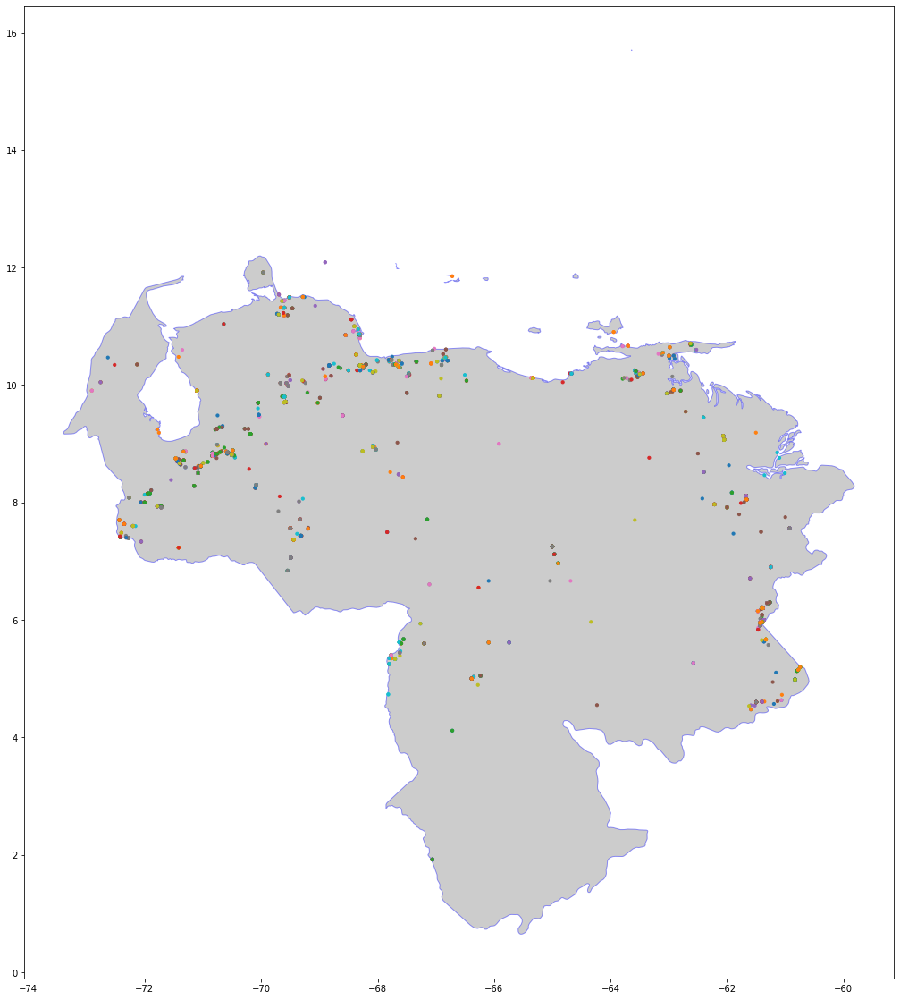

In [16]:
fig, ax = plt.subplots(figsize = (20, 20))

venezuela_map.plot(ax=ax, 
                 alpha=0.4, 
                 color="grey", 
                 edgecolor='blue')


geo_df.plot(ax = ax,
            column = "full_ssp_name",
            markersize=10,
            legend=False)

Create a interactive map

In [91]:
A_B_quality_coor_df.columns

Index(['id', 'gen', 'sp', 'ssp', 'en', 'rec', 'cnt', 'loc', 'lat', 'lng',
       'alt', 'type', 'url', 'file', 'file-name', 'lic', 'q', 'length', 'time',
       'date', 'uploaded', 'also', 'rmk', 'bird-seen', 'playback-used',
       'sono.small', 'sono.med', 'sono.large', 'sono.full', 'full_sp_name',
       'full_ssp_name', 'plot_ID', 'count'],
      dtype='object')

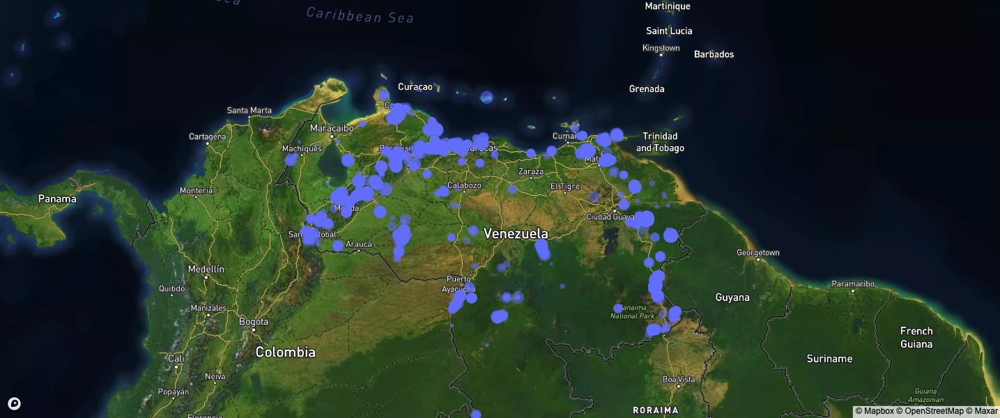

In [93]:
# px.set_mapbox_access_token(open(".mapbox_token").read())
token = open(".mapbox_token").read() # you will need your own token
fig = px.scatter_mapbox(A_B_quality_coor_df,
                        lat=geo_df.geometry.y,
                        lon=geo_df.geometry.x,
                        hover_data=["rec", "loc"],
                        size = "count",
                        size_max=15,
                        opacity = 0.5,
                        hover_name="full_ssp_name",
                        zoom=5)
fig.update_layout(height=600, 
                  mapbox_accesstoken=token,
                mapbox_style = "satellite-streets",
                margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

## To do: 
  - find and add layer for hidrologic resources
  - subset data of northern Orinoco river
  - Extract audio files